In [1]:
import matplotlib
from matplotlib import pyplot as plt
import pandas as pd
import os

In [2]:
# https://cern.ch/cmslumi/publicplots/lumiByDay.csv
lumi = pd.read_csv('lumiByDay.csv')
lumi.head()

,Date,Delivered(/ub),Recorded(/ub)
0,2010-03-30,2.960,2.766
1,2010-03-31,11.480,9.965
2,2010-04-01,10.656,9.093
3,2010-04-02,0.000,0.000
4,2010-04-03,0.019,0.019


In [3]:
lumi['Date'] = pd.to_datetime(lumi.Date)

# Run 2
min_date = pd.Timestamp(year=2015, month=6, day=3)
max_date = pd.Timestamp(year=2018, month=10, day=26)

lumi = lumi[(lumi.Date <= max_date) & (lumi.Date >= min_date)]

lumi['CMS recorded'] = lumi['Recorded(/ub)'].cumsum() / 1e9
lumi['LHC delivered'] = lumi['Delivered(/ub)'].cumsum() / 1e9

lumi.tail()

,Date,Delivered(/ub),Recorded(/ub),CMS recorded,LHC delivered
3128,2018-10-22,5.720798e+08,5.394481e+08,149.802034,162.323822
3129,2018-10-23,7.546789e+08,6.732612e+08,150.475295,163.078501
3130,2018-10-24,9.130657e+07,8.310897e+07,150.558404,163.169807
3131,2018-10-25,0.000000e+00,0.000000e+00,150.558404,163.169807
3132,2018-10-26,2.740343e+06,2.407608e+06,150.560812,163.172547


In [4]:
cms_orange= (0.945, 0.76, 0.157)
cms_blue = (0.0, 0.596, 0.831)

from matplotlib.font_manager import FontProperties
import matplotlib.dates as mdates
import matplotlib.lines as mlines

FONT_PROPS_SUPTITLE = FontProperties(size="x-large", weight="bold", stretch="condensed")
FONT_PROPS_TITLE = FontProperties(size="large", weight="regular")
FONT_PROPS_AX_TITLE = FontProperties(size="x-large", weight="bold")
FONT_PROPS_TICK_LABEL = FontProperties(size="large", weight="bold")
DATE_FMT_STR_AXES = "%-d %b"

matplotlib.rcParams["font.size"] = 10.8 
matplotlib.rcParams["axes.labelweight"] = "bold"

/Users/mccauley/anaconda/lib/python3.5/site-packages/pandas/plotting/_core.py:1716: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  series.name = label
/Users/mccauley/anaconda/lib/python3.5/site-packages/pandas/plotting/_core.py:1716: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  series.name = label
/Users/mccauley/anaconda/lib/python3.5/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


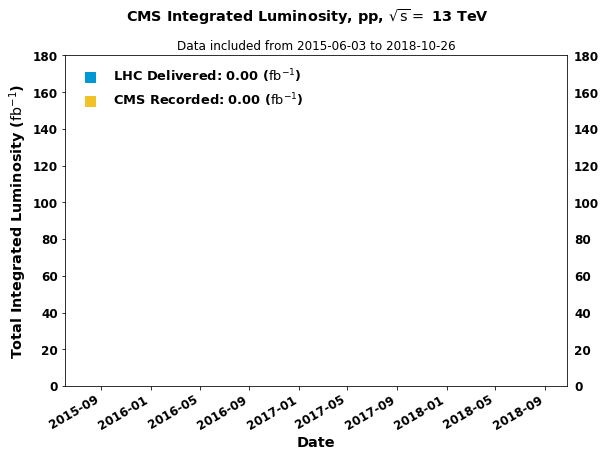

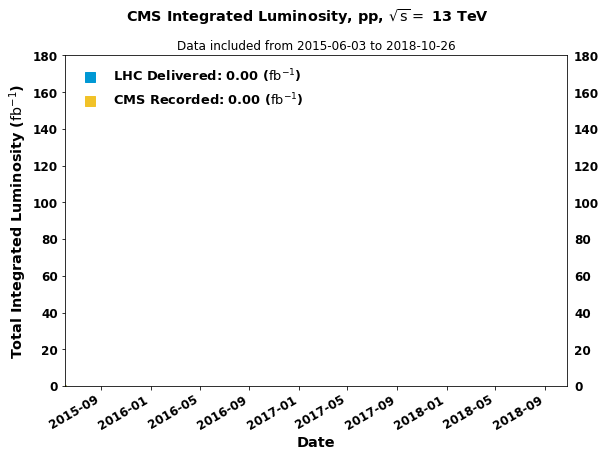

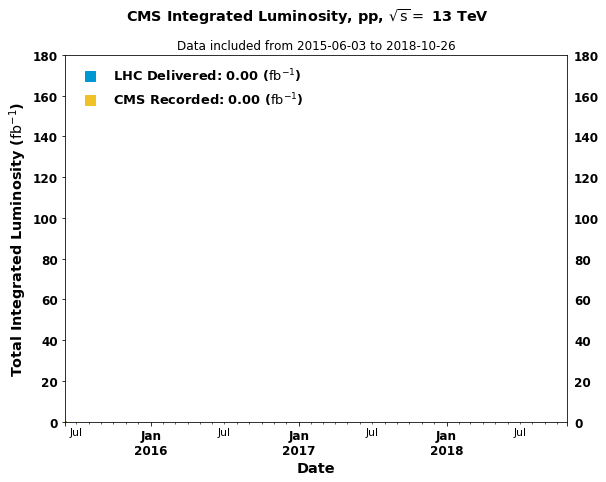

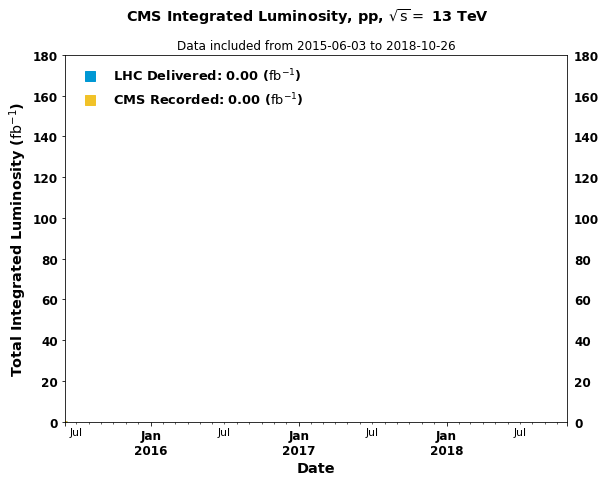

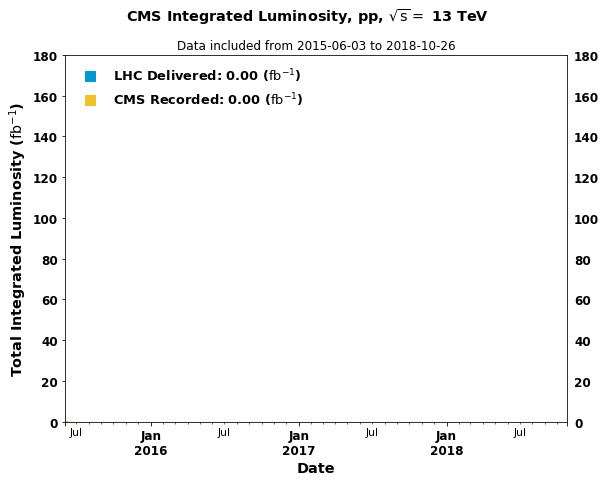

...

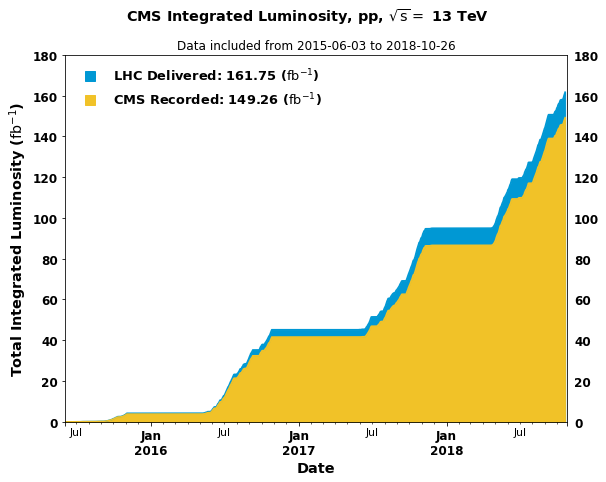

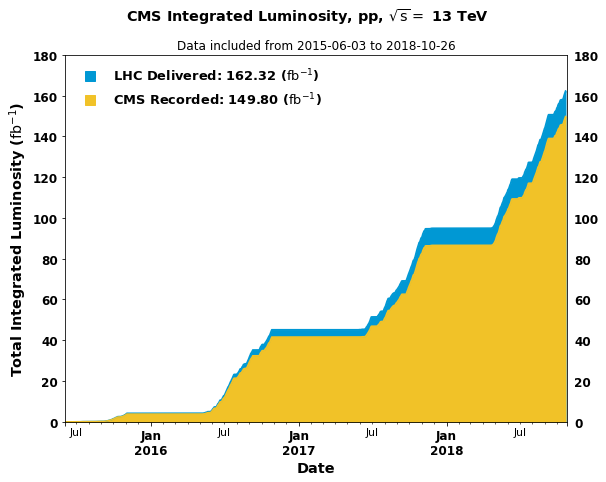

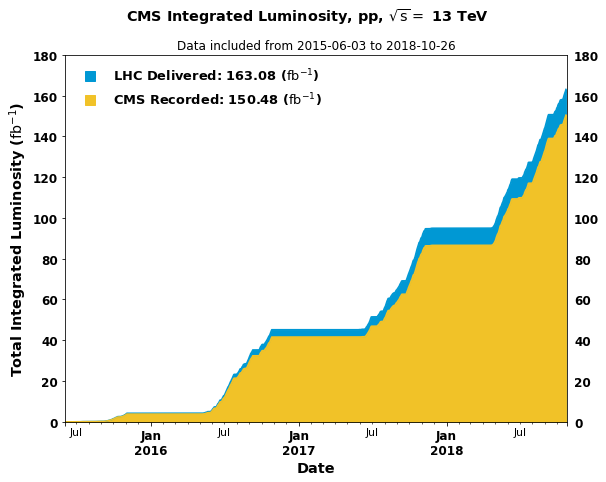

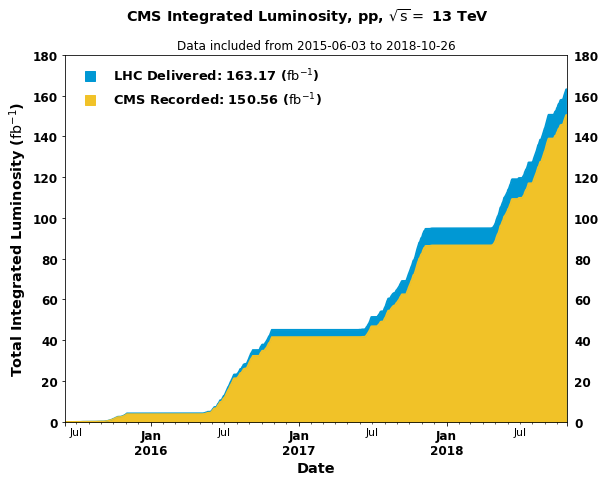

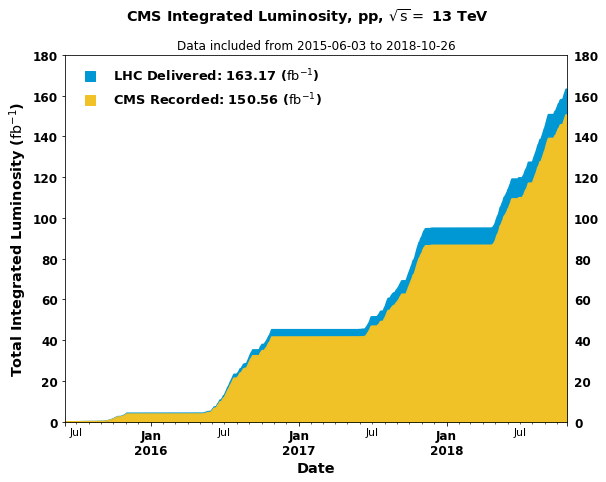

In [5]:
for i in range(2,len(lumi)):
    
    axes = lumi[1:i].plot(x='Date', y=['LHC delivered', 'CMS recorded'], 
                   kind='area', stacked=False, figsize=(12*0.75,9*0.75), 
                   color=[cms_blue, cms_orange], alpha=1.0)
    
    axes.tick_params(axis='y', which='both', labelright=True)
    
    ylocs, ylabels = plt.yticks() 
    for label in ylabels:
        label.set_font_properties(FONT_PROPS_TICK_LABEL)
        
    xlocs, xlabels = plt.xticks() 
    for label in xlabels:
        label.set_font_properties(FONT_PROPS_TICK_LABEL)
    
    lumi_delivered = '{0:.2f}'.format(lumi[1:i]['LHC delivered'].values[-1])
    lumi_recorded = '{0:.2f}'.format(lumi[1:i]['CMS recorded'].values[-1])
    
    plt.suptitle('CMS Integrated Luminosity, pp, $\mathrm{\sqrt{s} =}$ 13 TeV', fontproperties=FONT_PROPS_SUPTITLE)
    plt.title('Data included from 2015-06-03 to 2018-10-26', fontproperties=FONT_PROPS_TITLE)

    plt.ylim(0, 180)
    plt.ylabel('Total Integrated Luminosity ($\mathrm{{fb}^{-1}}$)', fontproperties=FONT_PROPS_AX_TITLE)

    plt.xlim(min_date, max_date)
    plt.xlabel('Date', fontproperties=FONT_PROPS_AX_TITLE)
    
    cms_square = mlines.Line2D([], [], color=cms_orange, 
                               label='CMS Recorded: '+lumi_recorded+' ($\mathrm{{fb}^{-1}}$)',
                               marker='s', linestyle='None', markersize=10)
    
    lhc_square = mlines.Line2D([], [], color=cms_blue, 
                               label='LHC Delivered: '+lumi_delivered+' ($\mathrm{{fb}^{-1}}$)',
                               marker='s', linestyle='None', markersize=10)
    
    plt.legend(handles=[lhc_square, cms_square],
               loc=2, frameon=False, 
               prop={'weight':'bold', 'size':'large'})
    
    plt.savefig('./images/lumi'+str(i-1)+'.png')